<a href="https://colab.research.google.com/github/dkalenov/Airbnb-Apartments-Rent/blob/main/Airbnb_Apartments_Rent.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Airbnb Berlin Apartments Rent

Business task from the customer: We are planning to invest in real estate. We want to buy some apartments/houses in Berlin to rent out on Airbnb. We need the most profitable options within the limited investment

***Project Objective:***

Select criteria for purchasing real estate in Berlin for rent on Airbnb.

***Tasks:***
- Analyze the data;
- Formulate hypotheses;
- Determine the list of criteria.

## Data Preprocessing

### Imports

In [1]:
!pip install pygwalker
!pip install folium

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.1/18.1 MB 19.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.3/993.3 kB 36.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 49.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 38.6 MB/s eta 0:00:00
  Attempting uninstall: duckdb
    Found existing installation: duckdb 0.10.2
    Uninstalling duckdb-0.10.2:
      Successfully uninstalled duckdb-0.10.2


#### Functions for data processing and EDA

In [2]:
# Function for displaying basic information about the dataset

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def basic_data_preprocessing(dataframe):
    # Convert all column titles to lowercase with "_" between words
    dataframe.columns = [x.lower().replace(' ', '_') for x in dataframe.columns.values]

    # Basic information about the dataset
    rows_num, columns_num = dataframe.shape
    print(f'Number of records: {rows_num}')
    print(f'Number of columns: {columns_num}\n')
    print('-' * 75)

    # Dataset information
    print("\nDataset Information:")
    display(dataframe.info())
    print()
    print('-' * 75)

    # Checking for missing values
    missing_values = dataframe.isnull().sum()
    if missing_values.sum() > 0:
        print("Missing values:")
        display(pd.DataFrame(missing_values, columns=['Missing Count']))
        display(dataframe[dataframe.isna().any(axis=1)])
    else:
        print("No missing values.")
    print('-' * 75)

    # Checking for zero-filled columns
    zero_columns = dataframe.columns[(dataframe == 0.0).any()]
    zero_count = dataframe[zero_columns].apply(lambda x: x.value_counts().get(0, 0))
    if zero_count.sum() != 0:
        print('Rows with value 0 found:')
        display(pd.DataFrame(zero_count, columns=['Zero Count']))
    else:
        print('No rows with value 0.')
    print('-' * 75)

    # Checking for duplicates
    if dataframe.duplicated().sum() > 0:
        print("Duplicate data found. Number of duplicates:", dataframe.duplicated().sum())
        display(dataframe[dataframe.duplicated(keep=False)])
    else:
        print("No duplicates found.")
    print('-' * 75)

    # Checking for negative values in the dataframe
    # Excluding columns with string data type (object type)
    dataframe_digits = dataframe.select_dtypes(exclude=['object'])
    if (dataframe_digits < 0).sum().sum() > 0:
        print("Negative values found:")
        display(pd.DataFrame((dataframe_digits < 0).sum(), columns=['Negative Value Count']))
    else:
        print('No negative values found.')
    print('-' * 75)

    # Statistical description of the data
    print("\nStatistical Description of the Data:\n")
    display(dataframe.describe())
    print('-' * 75)

    # Data Distribution
    print("\nData Distribution:")

    # Determine the number of graphs and rows for the subplots
    num_graphs = len(dataframe.columns)
    num_rows = (num_graphs + 1) // 2
    fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, num_rows * 4))

    for i, column in enumerate(dataframe.columns):
        ax = axes[i // 2, i % 2]  # Get the current axis from the subplot grid

        # Categorical feature: countplot
        if dataframe[column].dtype == 'object':
            sns.countplot(data=dataframe, x=column, ax=ax, color='dodgerblue')
            ax.tick_params(axis='x')
            total = float(len(dataframe[column]))
            for p in ax.patches:
                height = p.get_height()
                ax.annotate(f'{height/total:.2%}', (p.get_x() + p.get_width() / 2., height), ha='center', va='bottom')

        # Numeric feature with less than 8 unique values: countplot
        else:
            if len(dataframe[column].unique()) < 8:
                sns.countplot(data=dataframe, x=column, ax=ax, color='dodgerblue')
                ax.tick_params(axis='x')
                total = float(len(dataframe[column]))
                for p in ax.patches:
                    height = p.get_height()
                    ax.annotate(f'{height/total:.2%}', (p.get_x() + p.get_width() / 2., height), ha='center', va='bottom')
            else:
                sns.histplot(data=dataframe, x=column, kde=True, ax=ax, color='dodgerblue')
                ax.axvline(dataframe[column].mean(), color='red', linestyle='--')
        # Set visualization properties for the current axis
        ax.grid(False)
        ax.set_title(column)
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.set_facecolor('white')
        ax.tick_params(top=False, bottom=False, left=False, right=False)

    # Adjust the layout and display the plot
    plt.tight_layout()
    plt.show()

In [3]:
# Function for detecting outliers in a dataframe
# Displays boxplots and a table with outlier information

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def detect_outliers(dataframe):
    outlier_table = pd.DataFrame(columns=['Column', 'Outlier Count', 'Outlier Percentage'])  # Creating a DataFrame to store outlier information

    for column in dataframe.columns:
        if dataframe[column].dtype != 'object' and len(dataframe[column].unique()) == 2:  # Checking for columns with binary values
            print(f"No outliers in column '{column}' as it has object type or binary values.")  # Printing a message indicating binary values
            outlier_table = pd.concat([outlier_table,
                                       pd.DataFrame({'Column': [column],
                                       'Outlier Count': ['NaN'],
                                       'Outlier Percentage': ['NaN']})],
                                       ignore_index=True)  # Updating the outlier table with binary value information
            print('*' * 75)
            print()
            continue  # Skipping to the next iteration if the column has binary values

        elif dataframe[column].dtype == 'object':
          continue

        q1 = dataframe[column].quantile(0.25)  # Calculating the first quartile
        q3 = dataframe[column].quantile(0.75)  # Calculating the third quartile
        iqr = q3 - q1  # Calculating the interquartile range
        lower_bound = q1 - 1.5 * iqr
        upper_bound = q3 + 1.5 * iqr

        # Counting the number of outliers
        outliers = dataframe[(dataframe[column] < lower_bound) | (dataframe[column] > upper_bound)]
        num_outliers = len(outliers)
        column_len = len(dataframe[column])

        if num_outliers == 0:
            print(f"No outliers in column '{column}'.")
            outlier_table = pd.concat([outlier_table,
                                       pd.DataFrame({'Column': [column],
                                                    'Outlier Count': [0],
                                                    'Outlier Percentage': [0]})],
                                                    ignore_index=True)  # Updating the outlier table with outlier count
        else:
            print(f"Outliers in column '{column}':")
            print(f"Outlier Count: {num_outliers}")
            print(f"Outlier Percentage of total observations: {(num_outliers / column_len) * 100:.2f}%")  # Calculating and displaying outlier percentage
            print("Outlier Values:", ", ".join(outliers[column].astype(str)))

            outlier_table = pd.concat([outlier_table,
                                       pd.DataFrame({'Column': [column],
                                       'Outlier Count': [num_outliers],
                                       'Outlier Percentage': [(num_outliers / column_len) * 100]})],
                                       ignore_index=True)  # Updating the outlier table with outlier information

            # Plotting the boxplot with outliers
            fig, ax = plt.subplots(figsize=(8, 6))
            sns.boxplot(data=dataframe, x=column, ax=ax)
            ax.set_title(f"Outlier Plot for column '{column}'")
            plt.show()

        print('*' * 75)
        print()

    display(outlier_table)

In [4]:
# Correlation analysis on a dataframe with a target feature using some specified correlation types

!pip install phik
from phik import phik_matrix

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

def correlation_analysis(dataframe, target_feature, correlation_types=['phik'], apply_abs=False):
    target_column = dataframe[target_feature] # Target feature
    correlation_data = [] # List to store correlations
    interval_cols = [col for col in dataframe.columns if col != target_feature] # Set interval columns for phik

    # Calculate correlation coefficients with the target feature for each column and specified correlation types
    for column in dataframe.columns:
        if column != target_feature:
            for corr_type in correlation_types:
                corr_value = None

                if corr_type == 'pearson':
                    corr_value = stats.pearsonr(target_column, dataframe[column])[0]
                elif corr_type == 'spearman':
                    corr_value = stats.spearmanr(target_column, dataframe[column]).correlation
                elif corr_type == 'kendall':
                    corr_value = stats.kendalltau(target_column, dataframe[column]).correlation
                elif corr_type == 'phik':
                    corr_value = phik_matrix(dataframe, interval_cols=interval_cols)[target_feature][column]
                # Apply absolute value, if specified
                if corr_value is not None and apply_abs:
                  corr_value = abs(corr_value)
                correlation_data.append((column, corr_type, corr_value))

    correlation_df = pd.DataFrame(correlation_data, columns=['Column', 'Correlation Type', 'Correlation Value'])  # Create DataFrame
    correlation_df_sorted = correlation_df.pivot(index='Column', columns='Correlation Type', values='Correlation Value')
    correlation_df_sorted = correlation_df_sorted[correlation_types] # Keep only specified correlation types
    correlation_df_sorted = correlation_df_sorted.sort_values(by=correlation_types, ascending=False) # Sort the data by specified correlation types


    # Correlation plot
    fig, axes = plt.subplots(nrows=1, ncols=len(correlation_types), figsize=(8 * len(correlation_types), 6))

    for i, corr_type in enumerate(correlation_types):
        corr_with_target = correlation_df_sorted[corr_type]
        corr_with_target_sorted = corr_with_target.sort_values(ascending=True) # Sort the data

        # Set plot parameters
        sns.barplot(data=corr_with_target_sorted.reset_index(), x='Column', y=corr_type, ax=axes[i], color='dodgerblue')


        axes[i].set_xlabel('Features')
        axes[i].set_ylabel('Correlation')
        axes[i].set_title(corr_type)
        axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=75)
    plt.tight_layout(pad=1)
    plt.show()


    # Top 2 features with the highest correlation for each specified correlation type
    top_columns = {}
    for corr_type in correlation_types:
        sorted_columns = correlation_df_sorted[corr_type].abs().sort_values(ascending=False)
        top_columns[corr_type] = sorted_columns.index[:2].tolist()

    # Display correlation table
    print(f"Correlation table with target feature '{target_feature}':")
    display(correlation_df_sorted)

    # Display the top 2 features with the highest correlation for each correlation type
    for corr_type in correlation_types:
        print()
        print(f"Top 2 features with highest correlation ({corr_type.capitalize()}):", top_columns[corr_type])

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 7.8 MB/s eta 0:00:00


In [5]:
# Function to find multicollinearity and print correlation matrix

import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from phik import phik_matrix

def find_multicollinearity(dataframe, methods=['phik'], threshold=0.8):
    # List to store all multicollinear tables
    multicollinear_tables = []

    # Iterate through each method in the list of methods
    for method in methods:
        # Convert method to lowercase
        method = method.lower()

        # Calculate correlation matrix using specified sort method
        if method in ['pearson', 'kendall', 'spearman']:
            corr_matrix = dataframe.corr(method=method).abs()
        elif method == 'phik':
            interval_cols = [col for col in dataframe.columns]
            corr_matrix = phik_matrix(dataframe, interval_cols=interval_cols)
        else:
            print(f"Invalid method: {method}")
            continue

        # Exclude correlation of a variable with itself
        np.fill_diagonal(corr_matrix.values, np.NaN)

        # Create a larger figure size based on the number of features
        n = corr_matrix.shape[0]
        fig_width = 6 + n * 0.5
        fig_height = 4 + n * 0.3

        # Plot correlation matrix as heatmap with adjusted figure size
        plt.figure(figsize=(fig_width, fig_height))
        sns.heatmap(corr_matrix, cmap='coolwarm', annot=True, fmt=".2f", mask=np.isnan(corr_matrix))
        plt.title(f"Correlation Matrix ({method})")
        plt.show()

        # Initialize an empty list to store multicollinear features
        multicollinear_table = []

        # Iterate through each pair of multicollinear features and their correlation percentages
        for i in range(n):
            for j in range(i+1, n):
                # Check if the correlation between the two features is above the threshold
                if corr_matrix.iloc[i, j] > threshold:
                    feature1 = corr_matrix.columns[i]
                    feature2 = corr_matrix.columns[j]
                    # Append the pair of multicollinear features and their correlation percentage to the list
                    multicollinear_table.append({'Feature 1': feature1, 'Feature 2': feature2, 'Correlation': corr_matrix.iloc[i, j]})

        # Create a dataframe from the list of multicollinear features
        multicollinear_table = pd.DataFrame(multicollinear_table)

        if not multicollinear_table.empty:
            # Sort the multicollinear table by correlation in descending order
            multicollinear_table = multicollinear_table.sort_values(by='Correlation', ascending=False)
            # Append the multicollinear table to the list of multicollinear tables
            multicollinear_tables.append((method, multicollinear_table))

    # Print all multicollinear tables
    if multicollinear_tables:
        for method, table in multicollinear_tables:
            print(f"\nMulticollinearity Table ({method})")
            display(table)
    else:
        print("\nNo features with high multicollinearity!")

### Data Extraction

In [6]:
import pandas as pd

df_wk = pd.read_csv('https://raw.githubusercontent.com/dkalenov/Airbnb-Apartments-Rent/main/berlin_weekdays.csv')
df_wend = pd.read_csv('https://raw.githubusercontent.com/dkalenov/Airbnb-Apartments-Rent/main/berlin_weekends.csv')

In [7]:
df_wk.head(3)

,Unnamed: 0,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat
0,0,185.799757,Private room,False,True,2.0,True,0,0,10.0,98.0,1,3.582211,0.174706,105.063708,16.019042,148.941114,30.710638,13.42344,52.49150
1,1,194.914462,Private room,False,True,5.0,False,0,1,9.0,86.0,1,3.525410,0.511922,75.339529,11.487002,106.442356,21.947685,13.46800,52.51900
2,2,176.217631,Private room,False,True,2.0,False,0,0,9.0,91.0,1,3.801713,0.281397,73.669176,11.232324,105.440205,21.741048,13.47096,52.51527


In [8]:
df_wend.head(3)

,Unnamed: 0,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat
0,0,185.799757,Private room,False,True,2,True,0,0,10.0,98.0,1,3.582222,0.174708,105.063613,16.013858,148.940768,31.511339,13.42344,52.4915
1,1,387.491820,Entire home/apt,False,False,6,False,0,1,10.0,93.0,2,6.082132,0.480956,52.877461,8.059614,66.884920,14.150816,13.50300,52.5090
2,2,194.914462,Private room,False,True,5,False,0,1,9.0,86.0,1,3.525398,0.511928,75.339762,11.483331,106.443168,22.520139,13.46800,52.5190


In [9]:
print(df_wk.shape)
print(df_wend.shape)

(1284, 20)
(1200, 20)


### Merging Datasets

In [10]:
# Let's merge two tables vertically, creating a 'yes'(1) and 'no'(0) column

df_wk['weekend'] = 0
df_wend['weekend'] = 1

berlin_df = pd.concat([df_wk, df_wend])
berlin_df.shape

(2484, 21)

In [11]:
# Remove unnecessary columns
berlin_df = berlin_df.drop(columns=['Unnamed: 0', 'multi', 'biz', 'attr_index', 'attr_index_norm', 'rest_index', 'rest_index_norm', 'room_shared', 'room_private'], axis=1)
berlin_df.head(2)

,realSum,room_type,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,lng,lat,weekend
0,185.799757,Private room,2.0,True,10.0,98.0,1,3.582211,0.174706,13.42344,52.4915,0
1,194.914462,Private room,5.0,False,9.0,86.0,1,3.525410,0.511922,13.46800,52.5190,0


After merging, the dataset may contain duplicates of apartments that differ slightly (in fact, the same apartment/house can be repeated several times and differ in the 'weekend', inaccuracies in determining coordinates, prices, etc.).

The problem is that the apartments do not have IDs in the dataset. Let's try to catch duplicates using apartment coordinates, and then compare them based on rental prices and person capacity.

- The coordinates will help determine whether the apartment is located in the same place (adjusted for possible errors in the data);

- Prices will help determine whether the price changes depending on the day of the week (if the owner sets one price on weekdays and another on weekends, we will keep both of these offers);
- The person capacity will help determine whether the number of residents varies depending on the day of the week (if the owner is ready to accommodate a certain number of visitors on weekdays, and a different number on weekends, we will keep both of these offers).

Let's also round data on coordinates and prices to the nearest hundredth to reduce the possible impact of initial erroneous data.

In [12]:
# Convert person_capacity to integer

berlin_df['person_capacity'] = berlin_df['person_capacity'].astype(int)

In [13]:
# Rounding coordinates and prices
berlin_df['lngRound'] = berlin_df['lng'].round(3)
berlin_df['latRound'] = berlin_df['lat'].round(3)
berlin_df['realSumRound'] = berlin_df['realSum'].round(3)

In [14]:
# Create a dataframe with unique 'lngRound', 'latRound', 'realSumRound' and 'person_capacity' values
unique_df = berlin_df.drop_duplicates(subset=['lngRound', 'latRound', 'realSumRound', 'person_capacity'], keep='first')

# Check if 'lngRound', 'latRound', 'realSumRound' and 'person_capacity'  match for unique
duplicates_with_same_location = unique_df.duplicated(subset=['lngRound', 'latRound', 'realSumRound', 'person_capacity']).value_counts()


print("Unique:", unique_df.shape)
print(duplicates_with_same_location)

Unique: (1932, 15)
False    1932
Name: count, dtype: int64


In [15]:
df = unique_df.copy()

In [16]:
df = df.drop(columns=['lngRound', 'latRound', 'realSumRound'])
df.head()

,realSum,room_type,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,lng,lat,weekend
0,185.799757,Private room,2,True,10.0,98.0,1,3.582211,0.174706,13.42344,52.49150,0
1,194.914462,Private room,5,False,9.0,86.0,1,3.525410,0.511922,13.46800,52.51900,0
2,176.217631,Private room,2,False,9.0,91.0,1,3.801713,0.281397,13.47096,52.51527,0
3,207.768533,Private room,3,True,10.0,97.0,1,0.982408,0.705573,13.42281,52.53139,0
4,150.743199,Private room,2,False,10.0,99.0,1,8.869697,2.187188,13.52440,52.47842,0


### Basic Data Preprocessing & Distribution

Number of records: 1932
Number of columns: 12

---------------------------------------------------------------------------

Dataset Information:
<class 'pandas.core.frame.DataFrame'>
Index: 1932 entries, 0 to 1199
Data columns (total 12 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   realsum                     1932 non-null   float64
 1   room_type                   1932 non-null   object 
 2   person_capacity             1932 non-null   int64  
 3   host_is_superhost           1932 non-null   bool   
 4   cleanliness_rating          1932 non-null   float64
 5   guest_satisfaction_overall  1932 non-null   float64
 6   bedrooms                    1932 non-null   int64  
 7   dist                        1932 non-null   float64
 8   metro_dist                  1932 non-null   float64
 9   lng                         1932 non-null   float64
 10  lat                         1932 non-null   float64
 11  weekend

None


---------------------------------------------------------------------------
No missing values.
---------------------------------------------------------------------------
Rows with value 0 found:


,Zero Count
host_is_superhost,1418
bedrooms,138
weekend,1272


---------------------------------------------------------------------------
No duplicates found.
---------------------------------------------------------------------------
No negative values found.
---------------------------------------------------------------------------

Statistical Description of the Data:



,realsum,person_capacity,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,lng,lat,weekend
count,1932.000000,1932.000000,1932.000000,1932.000000,1932.000000,1932.000000,1932.000000,1932.000000,1932.000000,1932.000000
mean,250.843825,2.821946,9.454969,94.313147,1.080228,5.187331,0.821049,13.400054,52.509413,0.341615
std,255.888853,1.221834,0.843865,6.708071,0.545479,3.654525,1.271411,0.070919,0.032927,0.474374
min,64.971487,2.000000,4.000000,20.000000,0.000000,0.180926,0.011382,13.116320,52.370000,0.000000
25%,144.900439,2.000000,9.000000,92.000000,1.000000,2.787674,0.273037,13.359875,52.491433,0.000000
50%,191.408806,2.000000,10.000000,96.000000,1.000000,4.266781,0.444821,13.405925,52.510000,0.000000
75%,287.697485,4.000000,10.000000,99.000000,1.000000,6.486691,0.795656,13.439647,52.530468,1.000000
max,5857.483407,6.000000,10.000000,100.000000,9.000000,25.284557,14.273577,13.711850,52.641410,1.000000


---------------------------------------------------------------------------

Data Distribution:


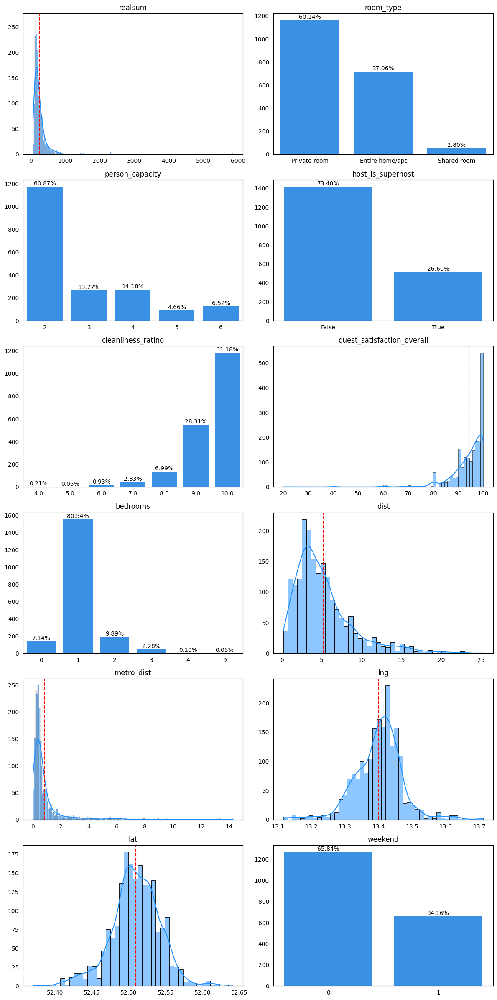

In [17]:
basic_data_preprocessing(df)

1.

* **Data Size**: Dataset contains 1932 records and 14 columns.
* **Data Types**: Most columns have appropriate data types for their content. It is necessary to change the data type into 'int' for 'person_capacity' and encode 'room_type'.
* **Missing Values**: There are no missing values in the dataset, allowing for analysis without additional preprocessing in this regard.
* **Zero Values**: There are zero values in several columns, such as 'room_shared', 'room_private', 'host_is_superhost', 'bedrooms', and 'weekend'. It is worth paying attention to 'bedrooms' during analysis to understand the reasons and potential implications.
* **Duplicates**: No duplicates are found in the dataset, indicating its relative cleanliness.
* **Negative Values**: There are no negative values, as expected.




*The distribution of realsum based on the plot:*

**realsum**:
- The distribution of realsum appears to be right-skewed (positively skewed).
Most values cluster towards the lower end, with a long tail extending towards higher values.
- This suggests that there are more low-priced listings, but some expensive outliers exist.



Overall, the data appears clean and ready for further analysis. Specifically, attention may be warranted on column with zero values ('bedroom') to better understand their significance.

In [18]:
# Encode 'room_type'

df['room_type'], _ = pd.factorize(df['room_type'])

In [19]:
# Check zero values in 'bedrooms'

df[df['bedrooms'] == 0]

,realsum,room_type,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,lng,lat,weekend
32,202.860615,1,3,False,8.0,80.0,0,5.445713,0.412160,13.34800,52.49800,0
73,194.680752,1,3,False,9.0,93.0,0,5.408402,0.292110,13.34311,52.50457,0
97,226.231654,1,5,False,10.0,99.0,0,9.407125,0.562035,13.31800,52.46400,0
112,388.426662,1,4,True,10.0,98.0,0,1.995532,0.372387,13.39753,52.50975,0
118,128.774423,0,2,True,10.0,97.0,0,8.087903,0.310699,13.30525,52.49748,0
...,...,...,...,...,...,...,...,...,...,...,...,...
943,202.860615,0,3,False,9.0,100.0,0,0.818407,0.292619,13.40462,52.52238,1
950,324.390016,1,3,False,10.0,100.0,0,0.756135,0.110472,13.40866,52.52822,1
1065,146.302702,0,2,True,9.0,96.0,0,3.004488,0.142467,13.41525,52.55042,1
1113,286.295223,1,3,False,10.0,95.0,0,17.653737,2.959554,13.15682,52.53269,1


It was not possible to establish unambiguous relationships with the value 0. It is quite possible that the information is just missing.
This column does not greatly influence the analysis and solution of the assigned tasks, so it was decided to leave the data without changes.

### Outliers

Outliers in column 'realsum':
Outlier Count: 123
Outlier Percentage of total observations: 6.37%
Outlier Values: 577.4983640272973, 904.6929045526782, 644.80695522109, 519.538188277087, 654.6227914368513, 695.7558193886135, 652.0519771898663, 624.0067308591193, 725.9044591941665, 660.9329718612695, 797.6535477236607, 611.1526596241937, 588.0153314013274, 644.80695522109, 539.1698607086098, 794.381602318407, 530.9899971954753, 554.3610358044311, 670.2813873048518, 1449.4718145274376, 505.5155651117135, 587.7816210152379, 564.8780031784612, 533.3271010563709, 614.4246050294474, 1159.437225390296, 742.030475834346, 742.030475834346, 611.1526596241937, 1507.431990277648, 745.7698420117789, 545.0126203608488, 730.3449565298681, 637.7956436384032, 913.5738992240814, 520.7067402075347, 755.3519678414508, 808.4042254837805, 505.5155651117135, 786.435449191362, 605.3098999719547, 539.1698607086098, 695.7558193886135, 624.9415724034776, 1380.0598298588388, 542.6755164999532, 534.4956529868186, 8

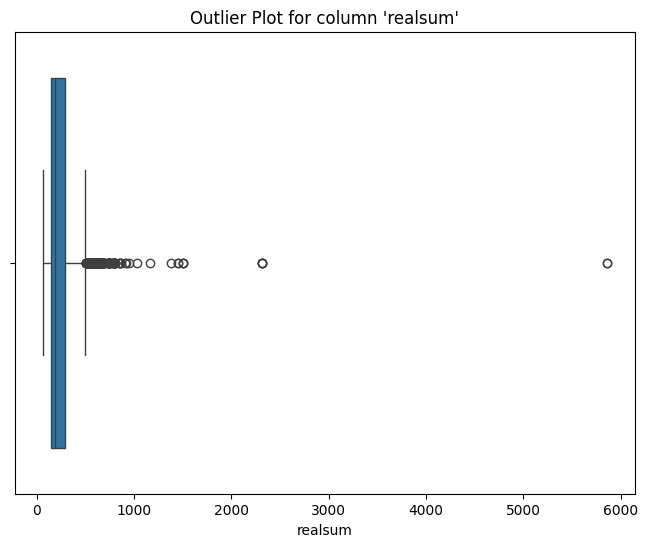

***************************************************************************

No outliers in column 'room_type'.
***************************************************************************

No outliers in column 'person_capacity'.
***************************************************************************

No outliers in column 'host_is_superhost' as it has object type or binary values.
***************************************************************************

Outliers in column 'cleanliness_rating':
Outlier Count: 68
Outlier Percentage of total observations: 3.52%
Outlier Values: 6.0, 7.0, 7.0, 7.0, 6.0, 7.0, 7.0, 7.0, 7.0, 4.0, 7.0, 5.0, 7.0, 7.0, 7.0, 6.0, 7.0, 7.0, 7.0, 7.0, 6.0, 6.0, 6.0, 6.0, 6.0, 4.0, 7.0, 7.0, 6.0, 7.0, 7.0, 7.0, 7.0, 4.0, 7.0, 7.0, 7.0, 7.0, 6.0, 7.0, 7.0, 7.0, 7.0, 7.0, 7.0, 7.0, 7.0, 7.0, 6.0, 6.0, 6.0, 7.0, 6.0, 7.0, 6.0, 6.0, 6.0, 7.0, 7.0, 6.0, 7.0, 7.0, 4.0, 7.0, 7.0, 7.0, 7.0, 7.0


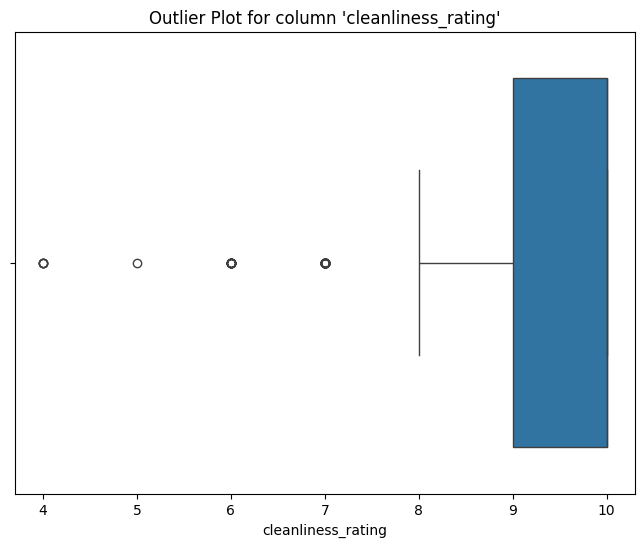

***************************************************************************

Outliers in column 'guest_satisfaction_overall':
Outlier Count: 96
Outlier Percentage of total observations: 4.97%
Outlier Values: 80.0, 80.0, 60.0, 78.0, 70.0, 80.0, 80.0, 81.0, 76.0, 80.0, 71.0, 79.0, 40.0, 80.0, 80.0, 80.0, 70.0, 80.0, 80.0, 69.0, 71.0, 60.0, 80.0, 40.0, 70.0, 80.0, 80.0, 80.0, 80.0, 80.0, 80.0, 80.0, 80.0, 80.0, 81.0, 80.0, 81.0, 80.0, 80.0, 79.0, 80.0, 60.0, 80.0, 67.0, 80.0, 40.0, 80.0, 70.0, 20.0, 80.0, 60.0, 60.0, 80.0, 80.0, 80.0, 60.0, 77.0, 80.0, 80.0, 75.0, 80.0, 80.0, 60.0, 80.0, 80.0, 78.0, 81.0, 70.0, 80.0, 76.0, 80.0, 80.0, 76.0, 67.0, 80.0, 80.0, 80.0, 80.0, 80.0, 81.0, 79.0, 60.0, 80.0, 40.0, 60.0, 73.0, 80.0, 80.0, 60.0, 80.0, 80.0, 81.0, 75.0, 80.0, 80.0, 80.0


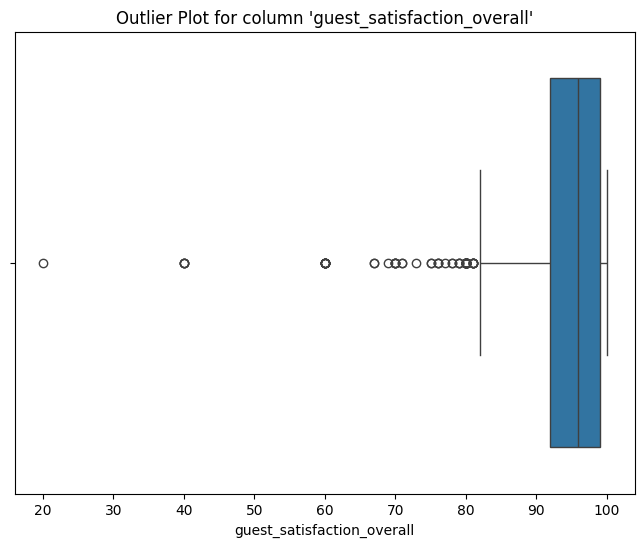

***************************************************************************

Outliers in column 'bedrooms':
Outlier Count: 376
Outlier Percentage of total observations: 19.46%
Outlier Values: 2, 2, 2, 2, 0, 3, 3, 0, 2, 2, 0, 0, 2, 0, 2, 3, 2, 0, 2, 3, 2, 2, 3, 2, 0, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 2, 0, 2, 2, 9, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 0, 3, 0, 0, 0, 2, 0, 0, 2, 3, 2, 0, 2, 2, 2, 0, 2, 0, 3, 0, 2, 2, 0, 0, 0, 0, 2, 0, 3, 0, 3, 0, 2, 4, 2, 2, 2, 0, 2, 2, 0, 0, 2, 0, 3, 3, 2, 2, 2, 3, 0, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 3, 2, 0, 2, 2, 3, 3, 3, 3, 0, 0, 0, 2, 2, 2, 2, 0, 2, 2, 3, 0, 2, 2, 0, 0, 3, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 3, 0, 0, 2, 3, 0, 2, 2, 0, 0, 2, 2, 0, 2, 3, 0, 2, 2, 2, 0, 2, 3, 2, 3, 0, 0, 2, 2, 0, 3, 3, 2, 2, 2, 2, 0, 0, 2, 2, 4, 2, 3, 2, 0, 2, 3, 2, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 3, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 2, 2, 2, 0, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2

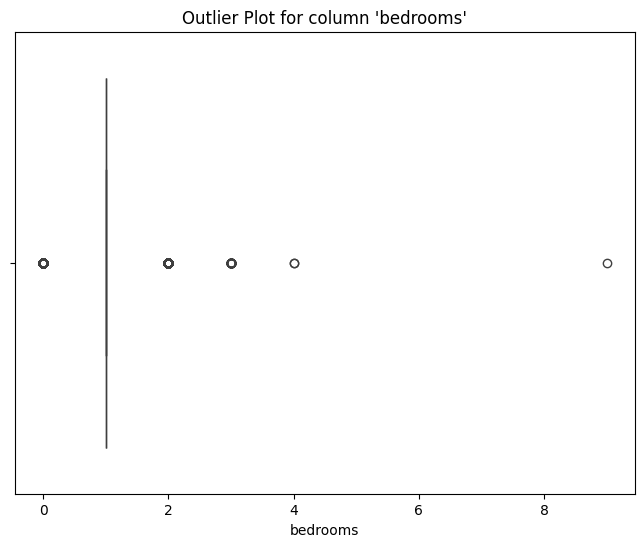

***************************************************************************

Outliers in column 'dist':
Outlier Count: 124
Outlier Percentage of total observations: 6.42%
Outlier Values: 13.62054945396812, 13.846346364219896, 13.627397780281434, 16.45966648587442, 12.634585487321504, 12.912668489058252, 13.50750294825502, 13.939761399965652, 12.067028735297194, 14.647749083829796, 13.105431731795056, 12.1667382078991, 13.831834345690442, 13.475693960846518, 14.757536539542428, 16.895526196613552, 16.0539250232139, 15.016248856273377, 15.365517229001478, 13.67409157414346, 14.04379971163096, 15.84735954954509, 14.78256732176425, 13.08354579866016, 12.976692716957508, 15.422942430599656, 15.96026829389208, 16.429284633811694, 14.81886079210348, 14.89231102360132, 12.8117884537718, 12.675608983068685, 12.481975608894926, 12.179741387122034, 12.635033889346191, 12.545144360773648, 15.497699185461752, 12.606871601497446, 13.660181350640586, 15.359640284872771, 18.674430074459494, 14.8867959

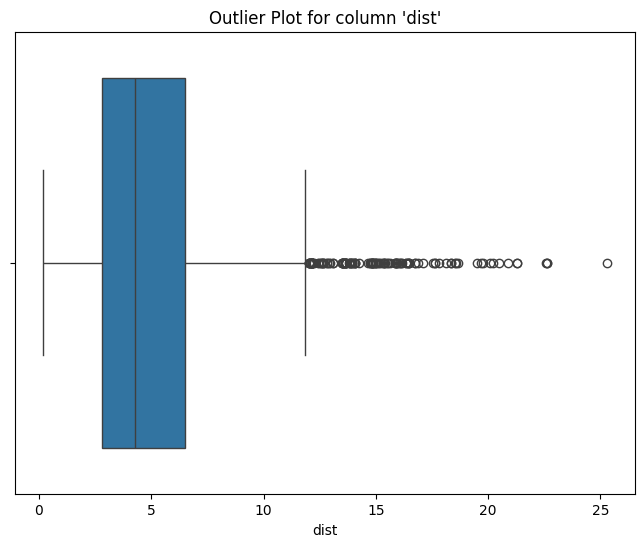

***************************************************************************

Outliers in column 'metro_dist':
Outlier Count: 207
Outlier Percentage of total observations: 10.71%
Outlier Values: 2.1871882566567384, 5.514004440826071, 2.6946382213132183, 3.229985869569345, 5.488170272188548, 1.690358587476368, 3.3962963302751032, 4.327186659207041, 1.8882106092923607, 1.7554839255158807, 1.832634130927316, 1.634300976835677, 2.7865536310265355, 4.151617220681039, 2.024229059664261, 3.091410030683748, 3.018013562676769, 2.2639045795063373, 1.871249556574176, 1.7832307689170706, 1.6905889838834445, 3.71237040040308, 4.597264651065028, 4.106835913377321, 3.9356603233908887, 2.07692306434172, 1.7584771937210348, 1.619068465237935, 1.7490489515484808, 5.455034117633234, 4.258359933421337, 3.1662786552556907, 2.2920899114532114, 2.67214598113713, 1.6922204469010969, 3.2514954299015977, 1.954534249279952, 2.0222420561437624, 2.770258239582553, 2.760423813791287, 4.163867115659261, 5.48302296676

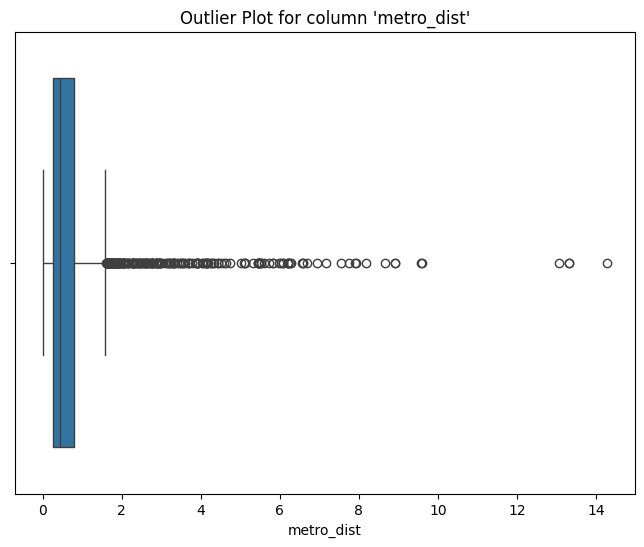

***************************************************************************

Outliers in column 'lng':
Outlier Count: 84
Outlier Percentage of total observations: 4.35%
Outlier Values: 13.58363, 13.21446, 13.58425, 13.19183, 13.582870000000002, 13.58005, 13.23285, 13.57979, 13.566820000000002, 13.21891, 13.21301, 13.23875, 13.63235, 13.5596, 13.60965, 13.59554, 13.57562, 13.6204, 13.634, 13.635279999999998, 13.623679999999998, 13.6142, 13.643, 13.6176, 13.62227, 13.6501, 13.59696, 13.58449, 13.61437, 13.62419, 13.63491, 13.5821, 13.22258, 13.19024, 13.14401, 13.20041, 13.236, 13.196129999999998, 13.18322, 13.2101, 13.156820000000002, 13.19943, 13.23308, 13.116320000000002, 13.1474, 13.14625, 13.124, 13.15359, 13.14459, 13.12703, 13.1214, 13.176420000000002, 13.15772, 13.143820000000002, 13.22805, 13.1928, 13.18997, 13.19742, 13.234000000000002, 13.707020000000002, 13.58363, 13.58425, 13.58005, 13.57979, 13.59554, 13.57562, 13.6204, 13.634, 13.71185, 13.5672, 13.6176, 13.6501, 13.20041,

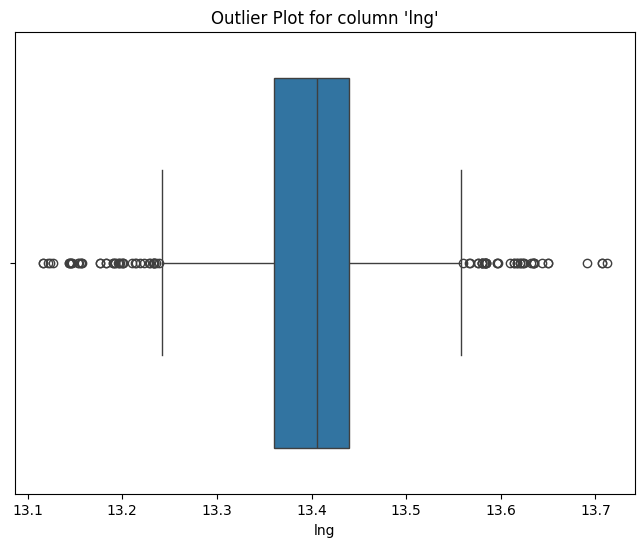

***************************************************************************

Outliers in column 'lat':
Outlier Count: 62
Outlier Percentage of total observations: 3.21%
Outlier Values: 52.61597, 52.60997, 52.6208, 52.60762, 52.60921999999999, 52.6008, 52.60825, 52.63311, 52.43012, 52.40845, 52.41019, 52.41194, 52.43039, 52.43046, 52.42207, 52.41, 52.410790000000006, 52.40017, 52.60025, 52.42663, 52.619130000000006, 52.64141, 52.63967, 52.61588, 52.42709, 52.42501, 52.41554, 52.42971, 52.42337, 52.42068, 52.42129, 52.42845, 52.42031, 52.43021, 52.382940000000005, 52.43036, 52.41233, 52.428, 52.40712, 52.42405, 52.603, 52.60762, 52.60921999999999, 52.63429, 52.60825, 52.42992, 52.42667, 52.42329, 52.43039, 52.43046, 52.42207, 52.410790000000006, 52.42166, 52.42663, 52.41266, 52.43, 52.41554, 52.428, 52.4, 52.40874, 52.42405, 52.37


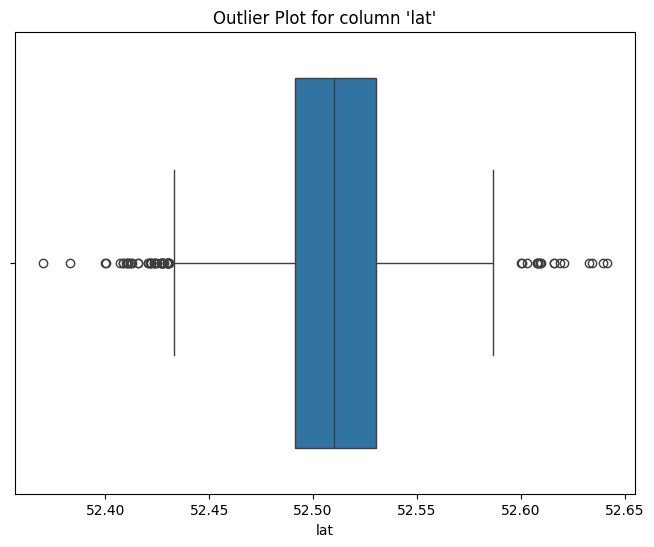

***************************************************************************

No outliers in column 'weekend' as it has object type or binary values.
***************************************************************************



,Column,Outlier Count,Outlier Percentage
0,realsum,123,6.36646
1,room_type,0,0.0
2,person_capacity,0,0.0
3,host_is_superhost,NaN,NaN
4,cleanliness_rating,68,3.519669
5,guest_satisfaction_overall,96,4.968944
6,bedrooms,376,19.461698
7,dist,124,6.418219
8,metro_dist,207,10.714286
9,lng,84,4.347826


In [20]:
detect_outliers(df)


Based on the outlier analysis, here are some conclusions:


**host_is_superhost, weekend**: bool type.

**room_type** and **person_capacity**: No outliers were detected in this column.

**realsum**: There are 123 outliers, which represent approximately 6.37% of the data in this column.

**cleanliness_rating**: There are 68 outliers, making up around 3.52% of the data in this column.

**guest_satisfaction_overall**: There are 96 outliers, constituting approximately 4.97% of the data.

**bedrooms**: This column has 376 outliers, which represent a substantial 19.46% of the data. The reason for that is that the majority of apartments/houses have 1 bedroom.

**dist**: There are 124 outliers, making up about 6.42% of the data in this column.

**metro_dist**: 207 outliers were detected, accounting for roughly 10.71% of the data.

**lng**: There are 84 outliers, representing around 4.35% of the data.

**lat**: 62 outliers were detected, constituting approximately 3.21% of the data.


### Correlations

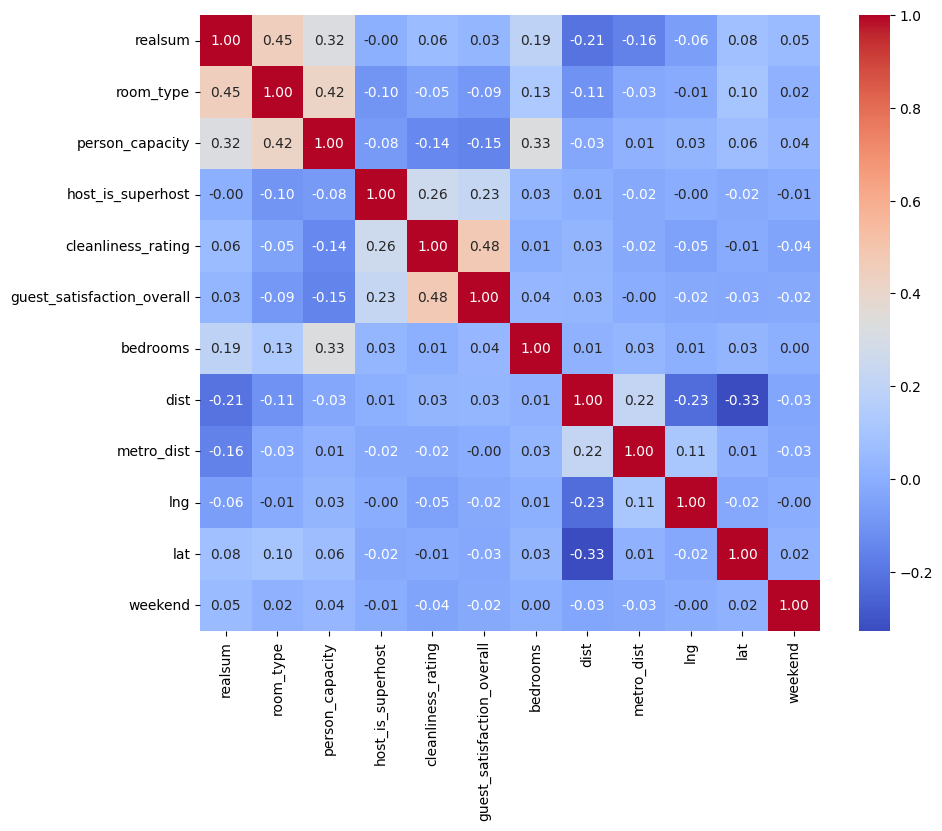

In [21]:
import seaborn as sns

# Compute Kendall correlation
kendall_corr = df.corr(method='kendall')

# Set the size of the heatmap
plt.figure(figsize=(10, 8))

# Create a heatmap to visualize correlations, excluding correlation with itself
sns.heatmap(kendall_corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

Based on the correlation matrix:

1. realsum:

There is a strong positive correlation with room_type (0.448328) and a moderate positive correlation with person_capacity (0.321570), indicating that certain types of rooms and accommodations with higher capacity tend to have higher costs.
There is a moderate negative correlation with dist (-0.205422) and metro_dist (-0.160936), suggesting that accommodations farther from the city center or metro tend to be cheaper.
There is also a positive correlation with lat (0.076729), indicating that accommodations located further south may have higher costs.
2. room_type:

There is a moderate positive correlation with realsum (0.448328) and person_capacity (0.418680), suggesting that certain types of rooms and accommodations with higher capacity tend to have higher costs.
There is a negative correlation with host_is_superhost (-0.095869), indicating that accommodations listed by superhosts might have lower costs.
3. person_capacity:

There is a moderate positive correlation with room_type (0.418680) and a weaker positive correlation with realsum (0.321570), suggesting that accommodations with higher capacity and certain types of rooms tend to have higher costs.
There is a negative correlation with cleanliness_rating (-0.140545) and guest_satisfaction_overall (-0.153301), implying that accommodations with lower cleanliness ratings and guest satisfaction scores might have lower costs.
4. host_is_superhost:

There is a positive correlation with cleanliness_rating (0.260158) and guest_satisfaction_overall (0.225673), indicating that accommodations listed by superhosts tend to have higher cleanliness ratings and guest satisfaction scores.
5. cleanliness_rating:

There is a positive correlation with host_is_superhost (0.260158) and guest_satisfaction_overall (0.479208), suggesting that accommodations with higher cleanliness ratings tend to be listed by superhosts and have higher guest satisfaction scores.
6. guest_satisfaction_overall:

There is a positive correlation with cleanliness_rating (0.479208), indicating that accommodations with higher guest satisfaction scores also tend to have higher cleanliness ratings.
7. bedrooms, dist, metro_dist, lng, lat, weekend:

These variables show weaker correlations with the target variable, suggesting less direct influence on accommodation costs.


### EDA Conclusion

Overall, the analysis confirms several intuitive expectations about the factors influencing accommodation cost, such as the number of bedrooms, distance from the city center or metro, and room type.

Next steps:
1. Analysis of the dependence of the accommodation price on the type of housing (room_type, person_capacity, bedrooms);

2. Analysis of the dependence of the price on the location of the property (dist, metro_dist and geolocation(lng and lat));

3. Analysis of the dependence of the price on the rating on the airbnb website (host_is_superhost, guest_satisfaction_overall, cleanliness_rating).

## The dependence of the accommodation price on the type of housing

### 1.1 Dependence of the price of accommodation on the: room_type and 'person_capacity'

In [22]:
import pygwalker as pyg

pyg.walk(df)

Box(children=(HTML(value='<div id="ifr-pyg-00061689f7f9d4514dqINE9MzYfnavmG" style="height: auto">\n    <head>…

In [23]:
round(df.groupby(['room_type', 'person_capacity'])['realsum'].aggregate(['median', 'min', 'max', 'count']), 2)

median     min      max  count
room_type person_capacity                                
0         2                153.08   64.97  1159.44    889
          3                168.27   92.78  2319.34    155
          4                188.84   92.78   622.60     91
          5                179.72  113.58   319.95     18
          6                287.70  138.12   426.76      9
1         2                254.98  111.25  1507.43    277
          3                260.82  122.93   765.17    109
          4                324.62  157.75  2317.00    163
          5                358.51  161.03  1029.49     69
          6                485.77  157.52  5857.48     98
2         2                133.45   81.33   300.32     10
          3                138.59  136.95   140.23      2
          4                151.33  125.27   417.64     20
          5                139.29  101.66   164.53      3
          6                143.73   75.02   208.70     19

In [24]:
spearman_rtype = stats.spearmanr(df['room_type'], df['realsum']).statistic
kendall_rtype = stats.kendalltau(df['room_type'], df['realsum']).correlation

print(f'Spearman correlation coefficient between room_type and realsum: {spearman_rtype}')
print(f'Kendall correlation coefficient between room_type and realsum: {kendall_rtype}')

Spearman correlation coefficient between room_type and realsum: 0.5532922159185271
Kendall correlation coefficient between room_type and realsum: 0.44832763188215113


In [25]:
spearman_percap = stats.spearmanr(df['person_capacity'], df['realsum']).statistic
kendall_percap = stats.kendalltau(df['person_capacity'], df['realsum']).correlation

print(f'Spearman correlation coefficient between person_capacity and realSum: {spearman_percap}')
print(f'Kendall correlation coefficient between person_capacity and realSum: {kendall_percap}')


Spearman correlation coefficient between person_capacity and realSum: 0.407223837319431
Kendall correlation coefficient between person_capacity and realSum: 0.32157040456790414


In [26]:
print(stats.spearmanr(df['room_type'],df['realsum']).statistic)
print(stats.kendalltau(df['room_type'], df['realsum']).correlation)

0.5532922159185271
0.44832763188215113


Price distribution by rental type and by day (weekdays, weekends)

Text(0.5, 1.0, 'Distribution of prices by room type and by days (weekday vs weekend)')

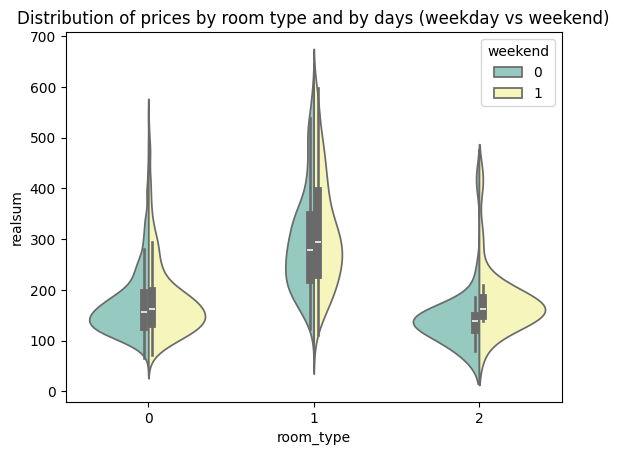

In [27]:
price_limit = df.query('realsum < 600')
sns.violinplot(y=price_limit['realsum'], x=price_limit['room_type'], hue=price_limit['weekend'], split=True, palette="Set3")
plt.title("Distribution of prices by room type and by days (weekday vs weekend)")

Housing distribution chart by type in Berlin

Text(0, 0.5, 'Latitude')

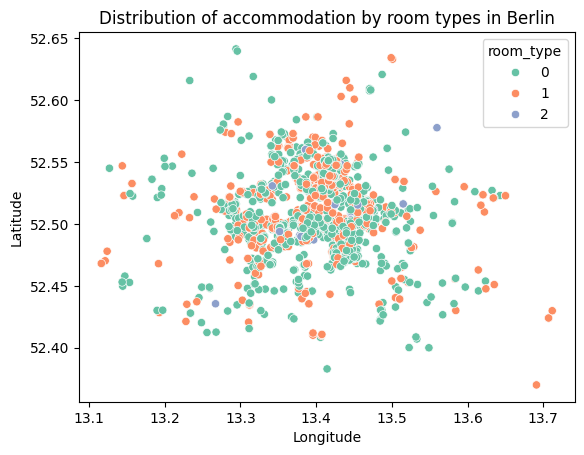

In [28]:
sns.scatterplot(data=df, x="lng", y="lat", hue="room_type", palette="Set2")
plt.title("Distribution of accommodation by room types in Berlin")
plt.xlabel("Longitude")
plt.ylabel("Latitude")

Price spread chart in Berlin

Text(0, 0.5, 'Latitude')

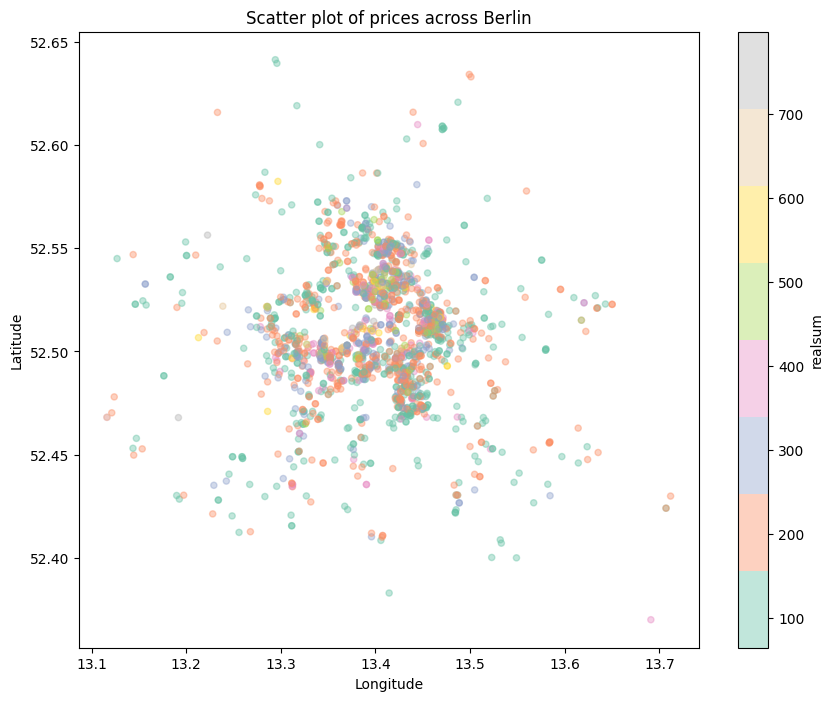

In [29]:
df[df.realsum < 800].plot(kind='scatter', x='lng', y='lat', c='realsum',
                  cmap=plt.get_cmap('Set2'), colorbar=True, alpha=0.4, figsize=(10,8))
plt.title("Scatter plot of prices across Berlin")
plt.xlabel("Longitude")
plt.ylabel("Latitude")

**Occupancy multipliers**

Average Occupancy Rates in Berlin is 44%

  Entire home/apartment score the highest occupancy rate at 46.9%

  Private rooms are slightly below at 46.3%

  Shared rooms have the lowest occupancy rate at 38.9%

[ссылка 1](https://airbtics.com/airbnb-regulation-in-berlin/#:~:text=Apart%20from%20complete%20houses%2C%20Berlin%27s,daily%20rate%20is%20%E2%82%AC108.)
[ссылка 2](https://medium.com/@ceisen/analysis-of-factors-that-influence-airbnb-occupancy-rates-8e75a9c56b5b)

**Conclusion:**

- *Shared room* has the lowest occupancy rate at 38.9%, and the rental price of the room needs to be divided by the number of people.
  - The room may not be fully occupied, resulting in lower revenue per night than the values stated in the table.
  - Maximum prices in this category are the lowest, indicating limited future price growth.
  - Additionally, the price/revenue depends on the day of the week - weekends are cheaper than weekdays.
  - This category is the least represented on Airbnb, indicating its unpopularity among tourists.

- *Private room* has an occupancy rate of 46.3%, with the entire room being rented out unlike shared rooms, potentially leading to higher earnings for the host.
  - Large rooms available for rent for 4 or more people on the market may be unpopular, with a high likelihood of vacancies (especially in the offseason).
  - Private rooms for 2 and 3 people have the highest maximum prices, indicating demand from customers willing to pay. Hosts can increase prices by improving room service and equipment.
  - An additional advantage is that prices do not depend on the day of the week.
  - Note that there are the most rooms for 2 people in Berlin - 1176 units, indicating the highest demand and competition.

- *Entire home/apt* has the highest occupancy rate at 46.9%.
  - There are a total of 359 apartments for 2 people in Berlin, the second-highest in terms of quantity, indicating the second-highest popularity.
  - However, the minimum and maximum prices of apartments for 2 people are higher than those of rooms for 2 people, which, with slightly higher occupancy rates, can result in higher and more stable income. Additionally, competition in this category is lower.

In conclusion, the most popular types of accommodation for rent are private rooms and apartments for 2 people. Given that the occupancy rate is slightly higher for apartments, as well as the prices, it is more profitable to invest in apartments. An alternative option is to rent out a flat by rooms.

### 1.2 Dependence of price on the number of bedrooms by type of housing

In [30]:
import pygwalker as pyg

pyg.walk(df)

Box(children=(HTML(value='<div id="ifr-pyg-00061689f830d266xBXcflG0Vu2TD57r" style="height: auto">\n    <head>…

In [31]:
spearman_bed = stats.spearmanr(df['bedrooms'],df['realsum']).statistic
kendall_bed = stats.kendalltau(df['bedrooms'], df['realsum']).correlation

print(f'Spearman correlation coefficient between the number of bedrooms and the real estate price: {spearman_bed}')
print(f'Kendall correlation coefficient between the number of bedrooms and the real estate price: {kendall_bed}')

Spearman correlation coefficient between the number of bedrooms and the real estate price: 0.2467240002656516
Kendall correlation coefficient between the number of bedrooms and the real estate price: 0.1948690661457041


Text(0.5, 1.0, 'Dependency of price on the number of bedrooms by room type')

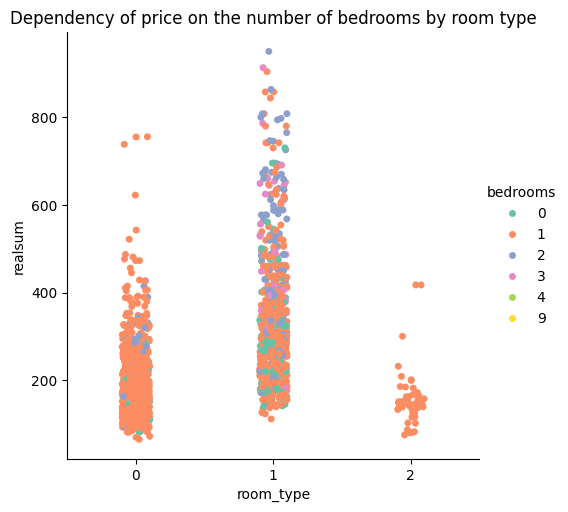

In [32]:
sns.catplot(data=df[df.realsum < 1000], x="room_type", y="realsum", hue="bedrooms", palette="Set2")
plt.title("Dependency of price on the number of bedrooms by room type")

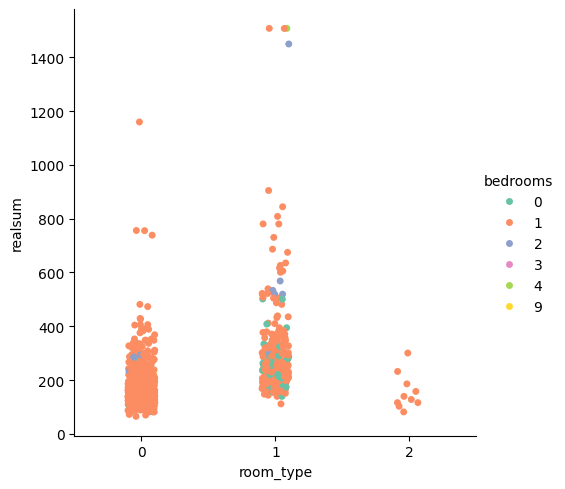

In [33]:
sns.catplot(data=df.query('person_capacity == 2'), x="room_type", y="realsum", hue="bedrooms", palette="Set2")

**Conclusion:**

Overall, the vast majority of housing is 1 bedroom housing. The “zero” rooms and apartments stand out a little, perhaps these are studios where there is no separate bedroom.

Shared rooms with only one shared bedroom.

Private rooms are mostly presented with only 1 bedroom up to ±280$. The price above includes 2 bedrooms in a room(?), perhaps there are some screens or partitions.

Entire home/apt already has both 2 and 3 bedrooms especially at prices over $300 per night.

Thus, if you rent out rooms, you need to equip one bedroom. If you rent out an entire apartment, then if there are 2 or more bedrooms, the price per night is higher.



## The dependence of the price on the location

### 2.1 Dependence of the price of accommodation on the distance to the city center (dist) and distance to the metro (metro_dist)

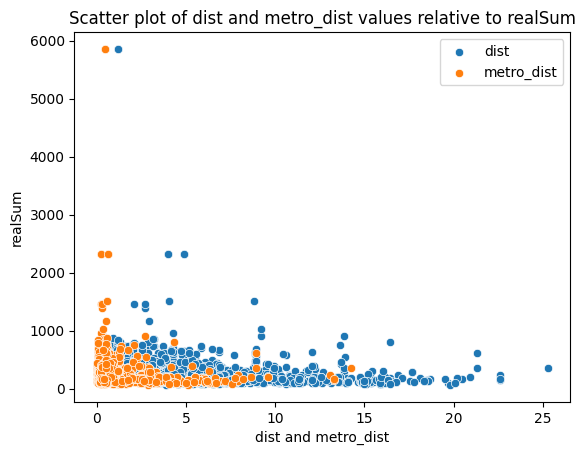

In [39]:
import seaborn as sns
import matplotlib.pyplot as plt

# Scatter plot
sns.scatterplot(x='dist', y='realsum', data=df, label='dist')
sns.scatterplot(x='metro_dist', y='realsum', data=df, label='metro_dist')

# Title and axis labels
plt.title('Scatter plot of dist and metro_dist values relative to realSum')
plt.xlabel('dist and metro_dist')
plt.ylabel('realSum')

plt.show()

In [42]:
# Spearman, and Kendall correlation coefficients between 'dist' and 'realsum'
spearman_dist = stats.spearmanr(df["realsum"], df["dist"]).correlation
kendall_dist = stats.kendalltau(df["realsum"], df["dist"]).correlation

print(f'Spearman correlation coefficient between dist and realsum: {spearman_dist}')
print(f'Kendall correlation coefficient between dist and realsum: {kendall_dist}')

Spearman correlation coefficient between dist and realsum: -0.3018554306352194
Kendall correlation coefficient between dist and realsum: -0.20542152207963107


In [43]:
# Spearman, and Kendall correlation coefficients between 'metro_dist' and 'realsum'
spearman_metro_dist = stats.spearmanr(df["realsum"], df["metro_dist"]).correlation
kendall_metro_dist = stats.kendalltau(df["realsum"], df["metro_dist"]).correlation

print(f'Spearman correlation coefficient between metro_dist and realsum: {spearman_metro_dist}')
print(f'Kendall correlation coefficient between metro_dist and realsum: {kendall_metro_dist}')

Spearman correlation coefficient between metro_dist and realsum: -0.23761370754315939
Kendall correlation coefficient between metro_dist and realsum: -0.1609356269063687


The coefficients indicate a weak negative relationship between dist and realSum; and metro_dist and realSum

Let's divide the variables dist and metro_dist into intervals by deciles. In each interval for the variable realSum we define: average, median, min., max. You can also take into account the types of housing and the number of people the apartment can accommodate

In [44]:
# Splitting dist and metro_dist into deciles

# Finding deciles for dist and metro_dist
deciles_dist = [df['dist'].quantile(i/10) for i in range(1, 11)]
deciles_metro_dist = [df['metro_dist'].quantile(i/10) for i in range(1, 11)]

# Determining the interval boundaries
intervals_dist = [df['dist'].min()] + deciles_dist
intervals_metro_dist = [df['metro_dist'].min()] + deciles_metro_dist

# Splitting variables into intervals
df['dist_interval'] = pd.cut(df['dist'], intervals_dist, include_lowest=True)
df['metro_dist_interval'] = pd.cut(df['metro_dist'], intervals_metro_dist, include_lowest=True)

# Removing parentheses from the values of the dist_interval and metro_dist_interval columns and adding "-" to the intervals
df['dist_interval'] = df['dist_interval'].astype(str).str.replace('(', '').str.replace(')', '').str.replace(',', ' - ').str.replace(']', '')
df['metro_dist_interval'] = df['metro_dist_interval'].astype(str).str.replace('(', '').str.replace(')', '').str.replace(',', ' - ').str.replace(']', '')

# Displaying the dataframe with intervals
df.head()

,realsum,room_type,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,lng,lat,weekend,dist_interval,metro_dist_interval
0,185.799757,0,2,True,10.0,98.0,1,3.582211,0.174706,13.42344,52.49150,0,3.577 - 4.267,0.169 - 0.245
1,194.914462,0,5,False,9.0,86.0,1,3.525410,0.511922,13.46800,52.51900,0,3.051 - 3.577,0.445 - 0.53
2,176.217631,0,2,False,9.0,91.0,1,3.801713,0.281397,13.47096,52.51527,0,3.577 - 4.267,0.245 - 0.314
3,207.768533,0,3,True,10.0,97.0,1,0.982408,0.705573,13.42281,52.53139,0,0.18 - 1.548,0.653 - 0.934
4,150.743199,0,2,False,10.0,99.0,1,8.869697,2.187188,13.52440,52.47842,0,7.3 - 9.905,1.692 - 14.274


In [45]:
# Table of values by intervals and number of people in the room for dist_inerval
df.groupby(['dist_interval', 'person_capacity'])["realsum"].aggregate(['min', 'max', 'mean','median', 'count'])

min          max        mean  \
dist_interval   person_capacity                                        
0.18 -  1.548   2                127.605871   844.161915  281.939711   
                3                157.520800   521.875292  259.982183   
                4                143.731887   542.675516  314.297190   
                5                126.437319   663.503786  380.013088   
                6                129.942975  5857.483407  746.237263   
1.548 -  2.507  2                102.131439  1449.471815  266.932612   
                3                139.291390   765.167804  305.576330   
                4                133.214920   660.699261  317.956488   
                5                139.291390   614.424605  388.520146   
                6                139.291390   742.030476  454.800411   
2.507 -  3.051  2                109.142750  1159.437225  211.916893   
                3                120.828270   347.761055  234.636572   
                4                157.520800   449.892493  288.388879   
                5                150.743199   611.152660  356.203842   
                6                182.060391  1449.004394  564.176872   
3.051 -  3.577  2                 91.614471   481.209685  188.158107   
                3                116.154062   415.069646  257.122070   
                4                113.583248   794.381602  320.909626   
                5                194.914462   405.954941  311.380138   
                6                295.643638   858.184538  547.094767   
3.577 -  4.267  2                 64.971487  1507.431990  199.915122   
                3                122.931663   487.052445  247.350574   
                4                142.797046  2317.004768  476.769188   
                5                101.664018   670.281387  316.385435   
                6                231.840703   730.578667  414.972266   
4.267 -  5.141  2                 86.940264   600.635692  177.265676   
                3                133.214920  2319.341872  380.636315   
                4                145.367860   624.006731  314.286536   
                5                278.349070   353.603814  304.135116   
                6                 75.021034   950.733851  452.658066   
5.141 -  5.89   2                 71.982799   738.524820  195.061879   
                3                116.154062   695.755819  256.171624   
                4                139.291390   417.640460  260.820791   
                5                182.060391   620.267365  310.180424   
                6                266.663551   532.392260  406.889782   
5.89 -  7.3     2                 81.331214   404.318968  167.644610   
                3                108.909040   276.011966  167.804057   
                4                111.246144   463.915116  252.491612   
                5                114.050668   670.281387  337.763444   
                6                274.843414   674.721885  383.285033   
7.3 -  9.905    2                 91.614471  1507.431990  178.855493   
                3                 92.783023   423.249509  205.912205   
                4                125.268767   577.264654  275.733739   
                5                182.995232  1029.494251  545.841230   
                6                138.122838   327.194541  218.110218   
9.905 -  25.285 2                 69.645695   904.692905  159.797313   
                3                102.131439   577.498364  186.517582   
                4                 92.783023   637.795644  222.398803   
                5                161.026456   746.938394  317.425446   
                6                157.520800   797.653548  374.170328   

                                     median  count  
dist_interval   person_capacity                     
0.18 -  1.548   2                243.526222    110  
                3                207.768533     17  
                4                324.623726     27  
                5             

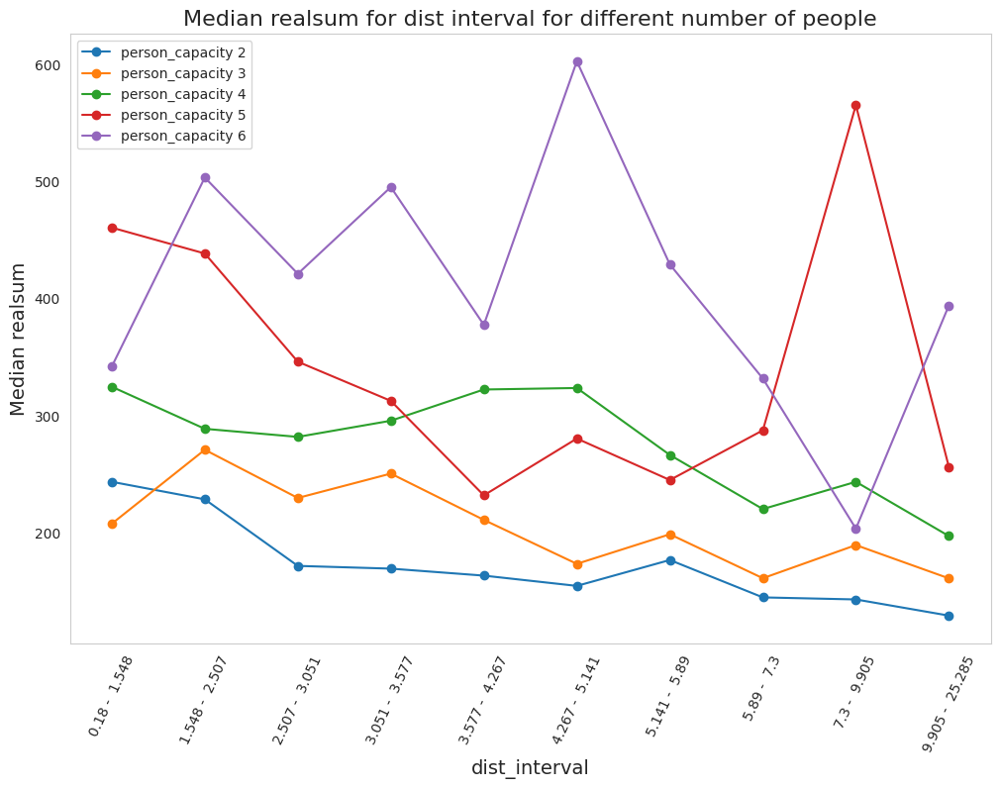

In [53]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn styles
sns.set_style("whitegrid")

person_capacity_list = [2, 3, 4, 5, 6]
plt.figure(figsize=(12, 8))

# Plot lines for each person capacity value
for person_capacity in person_capacity_list:
    filtered_df = df[(df['person_capacity'] == person_capacity)]
    grouped_df = filtered_df.groupby(['dist_interval'])["realsum"].median().reset_index()

    plt.plot(grouped_df['dist_interval'], grouped_df['realsum'], label=f'person_capacity {person_capacity}', marker='o')

# Add title and axis labels
plt.title('Median realsum for dist interval for different number of people', fontsize=16)
plt.xlabel('dist_interval', fontsize=14)
plt.ylabel('Median realsum', fontsize=14)

# Rotate X-axis labels
plt.xticks(rotation=65)

# Add legend
plt.legend()
plt.grid(False)
plt.show()

- For apartments or houses accommodating 2 people, the median rental price gradually decreases with distance from the center.
- For accommodations catering to 3 people, there's an interesting trend: within the first 3.6 km from the center, the rental price increases, but beyond that, it starts to decrease.
- Apartments or houses for 4 people follow a nuanced pattern: within the initial 3 kilometers from the center, the median cost decreases, but from 3 to 4.2 km, it increases before gradually declining again.
- Interestingly, for accommodations for 5 people, as the distance increases up to 4.2 km, there's a sharp decrease in rental prices, followed by a gradual increase towards values closer to the center.
- Lastly, for groups of 6 people, there's a fluctuating trend: within 2.5 km from the center, rental prices rise, then decrease with increasing distance. However, between 4.2 and 5.2 km, there's a notable increase, followed by another decrease until reaching a distance of 10 km. Beyond 10 km, there's a slight increase again up to 25 km.

In [54]:
# Values by intervals and number of people in the room for metro_dist_inerval
df.groupby(['metro_dist_interval', 'person_capacity'])["realsum"].aggregate(['min', 'max', 'mean','median', 'count'])

min          max         mean  \
metro_dist_interval person_capacity                                         
0.0104 -  0.169     2                 92.549313   844.161915   256.491306   
                    3                113.583248   521.875292   280.512776   
                    4                148.406095   542.675516   355.512449   
                    5                101.664018   577.498364   364.144153   
                    6                254.978031   808.404225   493.160076   
0.169 -  0.245      2                 95.120127  1449.471815   240.542069   
                    3                140.226232  2319.341872   388.944889   
                    4                111.246144   794.381602   359.712744   
                    5                113.583248   353.603814   239.973824   
                    6                272.506310   950.733851   541.799103   
0.245 -  0.314      2                 81.331214   738.524820   205.555588   
                    3                147.237543   370.898383   238.514433   
                    4                153.080303   505.515565   309.399164   
                    5                114.050668   458.072357   306.072964   
                    6                162.428718  1449.004394   576.417453   
0.314 -  0.371      2                 71.982799   504.580724   204.686614   
                    3                120.828270   487.052445   225.156586   
                    4                117.790035   660.699261   329.156291   
                    5                128.540712  1029.494251   462.656676   
                    6                148.406095   858.184538   469.352778   
0.371 -  0.445      2                 83.434608   519.538188   195.533695   
                    3                110.311302   660.932972   224.317454   
                    4                119.426007   637.795644   297.244987   
                    5                150.743199   663.503786   352.739086   
                    6                129.942975   742.030476   383.934229   
0.445 -  0.53       2                 81.331214  1159.437225   212.480056   
                    3                122.931663   765.167804   274.098462   
                    4                139.057680   487.052445   261.899983   
                    5                133.214920   620.267365   345.294112   
                    6                143.731887  5857.483407  1147.985416   
0.53 -  0.653       2                 91.848182  1507.431990   206.661484   
                    3                124.100215   695.755819   231.942316   
                    4                133.214920  2317.004768   381.224133   
                    5                126.437319   670.281387   375.712817   
                    6                138.122838   864.027297   369.855675   
0.653 -  0.934      2                 83.668318   347.761055   170.991017   
                    3                133.214920   353.603814   207.528331   
                    4                126.437319   530.989997   298.325158   
                    5                146.302702   611.152660   356.719953   
                    6                 79.928952   426.755165   244.139712   
0.934 -  1.692      2                 81.331214   347.994765   162.348915   
                    3                 92.783023   577.498364   198.903657   
                    4                 92.783023   472.094980   258.249977   
                    5                155.417407   680.798355   524.679817   
                    6                 75.021034   742.030476   407.746720   
1.692 -  14.274     2                 64.971487   904.692905   168.245020   
                    3                102.131439   545.012620   188.944831   
                    4                109.142750   371.132093   207.441339   
                    5                161.026456   746.938394   284.064351   
                    6                157.520800   797.653548   387.024399   

                                       

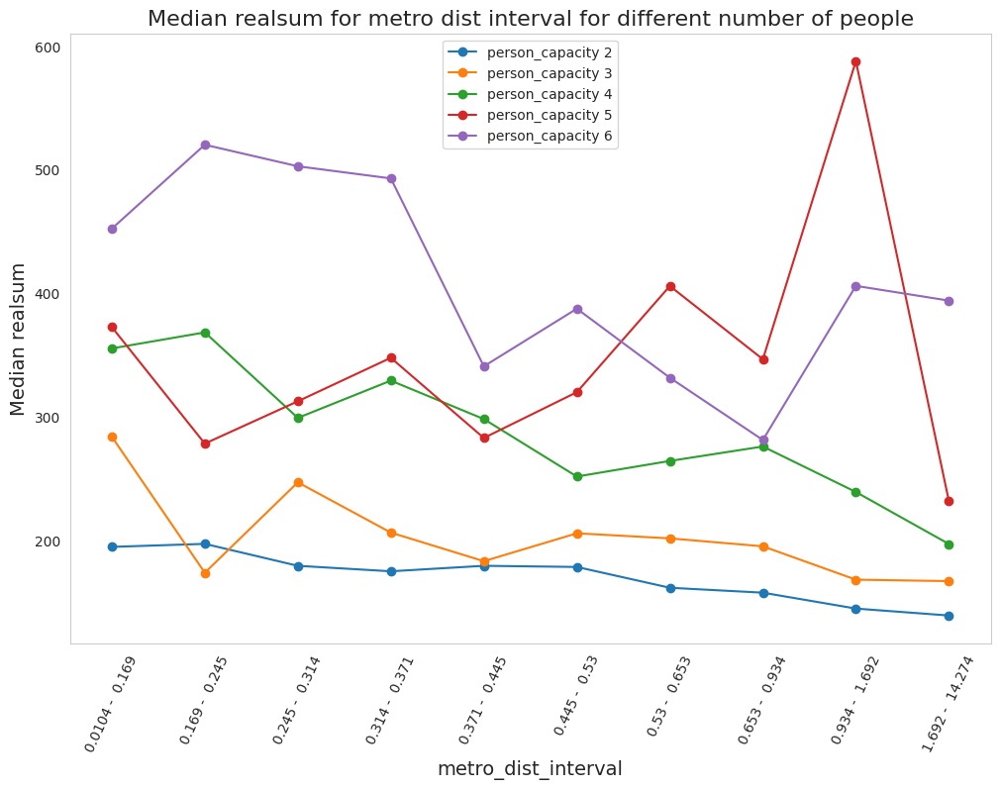

In [55]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn styles
sns.set_style("whitegrid")

person_capacity_list = [2, 3, 4, 5, 6]
plt.figure(figsize=(12, 8))

# Plot lines for each person capacity value
for person_capacity in person_capacity_list:
    filtered_df = df[(df['person_capacity'] == person_capacity)]
    grouped_df = filtered_df.groupby(['metro_dist_interval'])["realsum"].median().reset_index()

    plt.plot(grouped_df['metro_dist_interval'], grouped_df['realsum'], label=f'person_capacity {person_capacity}', marker='o')

# Add title and axis labels
plt.title('Median realsum for metro dist interval for different number of people', fontsize=16)
plt.xlabel('metro_dist_interval', fontsize=14)
plt.ylabel('Median realsum', fontsize=14)

# Rotate X-axis labels
plt.xticks(rotation=65)

# Add legend
plt.legend()
plt.grid(False)
plt.show()


* Median rental costs generally decrease with distance from the metro for all person capacities except when it equals 5.

* However, for person_capacity = 5, there's an interesting trend: rental costs tend to increase as the distance from the metro increases.



### 2.2 Location of houses/apartments based on lng and lat data

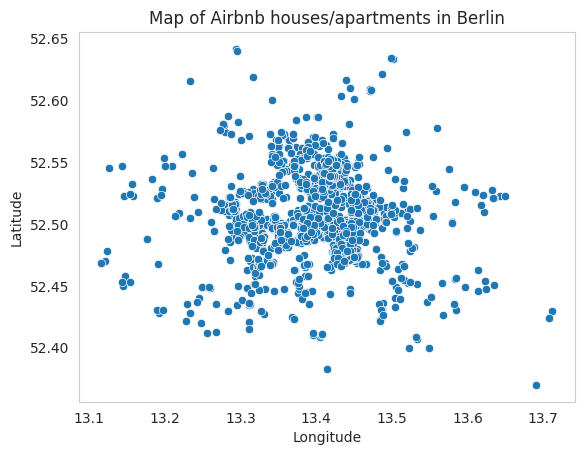

In [57]:
# Location of houses/apartments on the map
import seaborn as sns
import matplotlib.pyplot as plt

# Building the map using Seaborn
sns.scatterplot(data=df, x='lng', y='lat')

# Setting the title and axis labels
plt.title('Map of Airbnb houses/apartments in Berlin')
plt.xlabel('Longitude')
plt.ylabel('Latitude')


plt.grid(False)
plt.show()

Let's display this data on a map of Berlin with a description of each house/apartment

In [61]:
# Enumerate the rows and assign the column name "id"
df['id'] = df.reset_index().index

In [ ]:
import folium

# Creating the central point of the map to accurately determine the map location
center_lat, center_lng = df['lat'].mean(), df['lng'].mean()

# Creating the Berlin map object
map_berlin = folium.Map(location=[center_lat, center_lng], zoom_start=11)

# Marking the location of houses on the map with popup information
for index, row in df.iterrows():
    tooltip = (f"ID: {row['id']}<br>\
              Rental Cost: {round(row['realsum'], 2)} €<br>\
              Room Type: {row['room_type']} <br>\
              Capacity: {row['person_capacity']} <br>\
              Superhost Status: {row['host_is_superhost']} <br>\
              Cleanliness Rating: {row['cleanliness_rating']} <br>\
              Guest Satisfaction Rating: {row['guest_satisfaction_overall']} <br>\
              Number of Bedrooms: {row['bedrooms']} <br>\
              Distance to Center: {round(row['dist'], 4)} km<br>\
              Distance to Metro: {round(row['metro_dist'], 4)} km<br>\
              Latitude and Longitude: {row['lat'], row['lng']}"
              )
    folium.Marker(location=[row['lat'], row['lng']], tooltip=tooltip).add_to(map_berlin)

# Displaying the map
map_berlin

##  The dependence of the price on the rating on Airbnb website

### 3.1 Analysis of the dependence of price on the final rating of the Airbnb host (guest_satisfaction_overall)

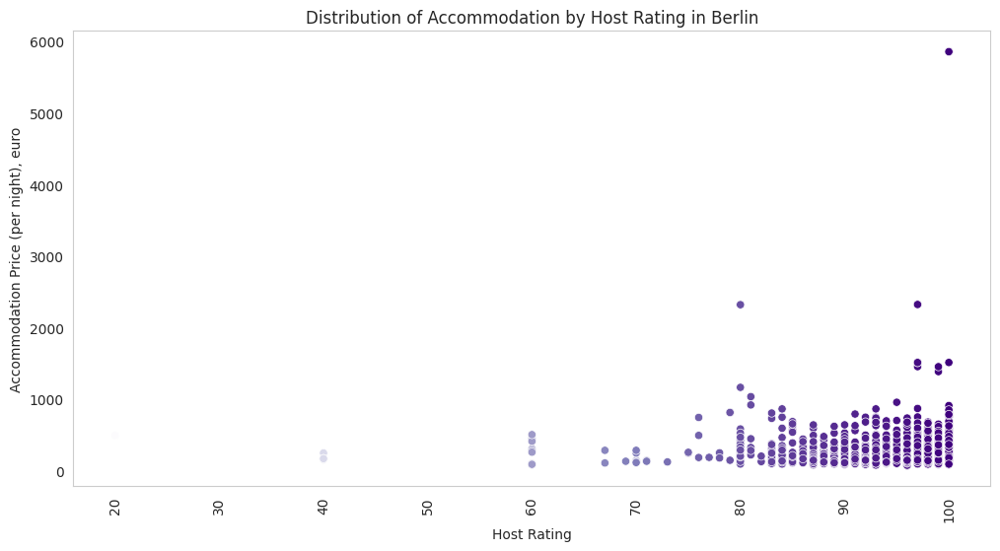

In [79]:
import seaborn as sns

# Set a custom color palette using a gradient from light purple to dark purple
custom_palette = sns.color_palette("Purples", as_cmap=True)

# Increase figure size
plt.figure(figsize=(12, 6))

# Plot the distribution of price and rating
sns.scatterplot(data=df, x="guest_satisfaction_overall", y="realsum", hue="guest_satisfaction_overall", palette=custom_palette, legend=False)

# Add title and labels
plt.title("Distribution of Accommodation by Host Rating in Berlin")
plt.xlabel("Host Rating")
plt.ylabel("Accommodation Price (per night), euro")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=90)

plt.grid(False)
plt.show()

In [80]:
# Divide the ratings into 4 buckets

df['rating_bucket'] = pd.cut(df['guest_satisfaction_overall'], [0, 60, 70, 80, 90, 100])

In [82]:
df.groupby('rating_bucket')['realsum'].aggregate(['median','mean', 'min','max']).round(1)

,median,mean,min,max
rating_bucket,,,,
"(0, 60]",252.6,269.0,79.9,498.5
"(60, 70]",129.2,172.7,101.7,278.3
"(70, 80]",196.8,324.2,86.9,2317.0
"(80, 90]",194.9,237.8,75.0,1029.5
"(90, 100]",191.2,250.5,65.0,5857.5


In [83]:
df[df['guest_satisfaction_overall'] < 60]

,realsum,room_type,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,lng,lat,weekend,dist_interval,metro_dist_interval,id,rating_bucket
393,150.743199,0,2,False,4.0,40.0,1,3.682170,0.324259,13.46914,52.51526,0,3.577 - 4.267,0.314 - 0.371,389,"(0, 60]"
505,241.189118,1,3,False,8.0,40.0,0,2.232246,0.749990,13.44944,52.52284,0,1.548 - 2.507,0.653 - 0.934,501,"(0, 60]"
837,162.428718,0,2,False,10.0,40.0,1,5.450306,0.170170,13.42650,52.47481,0,5.141 - 5.89,0.169 - 0.245,828,"(0, 60]"
905,487.052445,1,2,False,10.0,20.0,1,1.125387,0.357046,13.40000,52.52400,0,0.18 - 1.548,0.314 - 0.371,896,"(0, 60]"
792,162.195008,0,2,False,10.0,40.0,1,5.450311,0.170154,13.42650,52.47481,1,5.141 - 5.89,0.169 - 0.245,1685,"(0, 60]"


The median placement price for ratings from 70 to 100 is practically the same. Therefore, you can buy real estate with a rating above 70. But perhaps the rating affects the popularity of housing (the number of days without rent per year).

### 3.2 Analysis of the dependence of price on the host’s superhost award (host_is_superhost)

<ipython-input-85-163e8b3d0c3e>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df, x="host_is_superhost", y="realsum", palette="Set2")


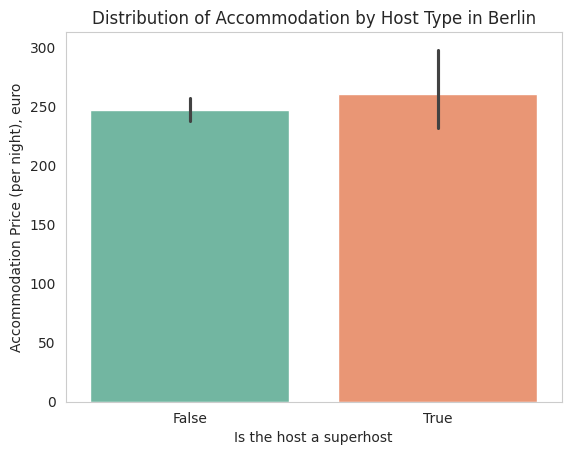

In [85]:
# Let's create a plot of the distribution of price and rating

sns.barplot(data=df, x="host_is_superhost", y="realsum", palette="Set2")


plt.title("Distribution of Accommodation by Host Type in Berlin")
plt.xlabel("Is the host a superhost")
plt.ylabel("Accommodation Price (per night), euro")


plt.grid(False)
plt.show()

<ipython-input-86-292a1827e375>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.catplot(data=df, x="host_is_superhost", y="realsum", palette="Set2")


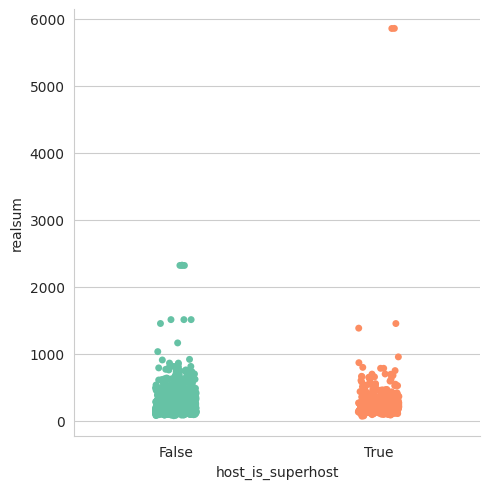

In [86]:
sns.catplot(data=df, x="host_is_superhost", y="realsum", palette="Set2")

In [88]:
host_df = df.query('host_is_superhost == 0')
superhost_df = df.query('host_is_superhost == 1')

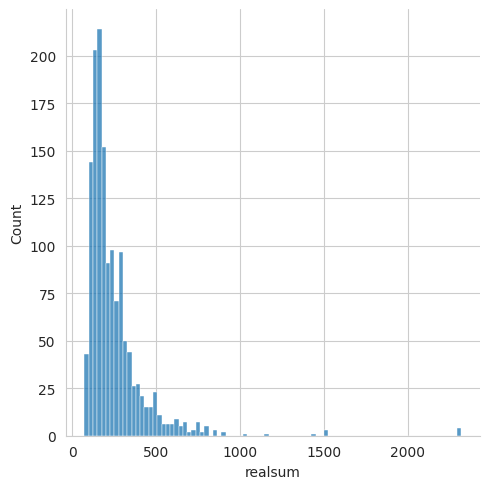

In [89]:
# Distribution

sns.displot(data=host_df, x='realsum')

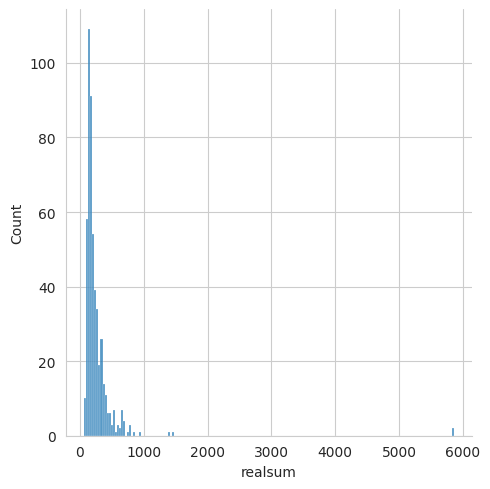

In [90]:
sns.displot(data=superhost_df, x='realsum')

In [92]:
stats.normaltest(host_df.realsum)

NormaltestResult(statistic=1518.3242307447942, pvalue=0.0)

In [93]:
stats.normaltest(superhost_df.realsum)

NormaltestResult(statistic=960.3246289766845, pvalue=2.938707760301466e-209)

In order to check the normality of the distribution, I use the D'Agostino-Pearson test using the scipy.stats.normaltest() function.

This test shows that the values in both groups are not normally distributed

In [94]:
# compare averages

host_df.realsum.mean()

247.1175828926898

In [95]:
superhost_df.realsum.mean()

261.12361406103525

In [96]:
# Let's check if the difference in means is statistically significant
from scipy.stats import mannwhitneyu

res = mannwhitneyu(host_df.realsum, superhost_df.realsum)
print(res)

MannwhitneyuResult(statistic=364948.0, pvalue=0.961612217907714)


The output MannwhitneyuResult(statistic=364948.0, pvalue=0.961612217907714) indicates that the Mann-Whitney U test statistic is approximately 364948.0, and the associated p-value is approximately 0.9616.


Based on the Mann-Whitney U test with a p-value of 0.9616, we do not have enough evidence to conclude that there is a statistically significant difference in rental prices between superhost and non-superhost properties. Therefore, we cannot conclude that the price depends on the superhost status.

### 3.3 Analysis of the dependence of price on the level of cleanliness (cleanliness_rating)

<ipython-input-98-5cf206363417>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=df, x="cleanliness_rating", y="realsum", palette="Set2")


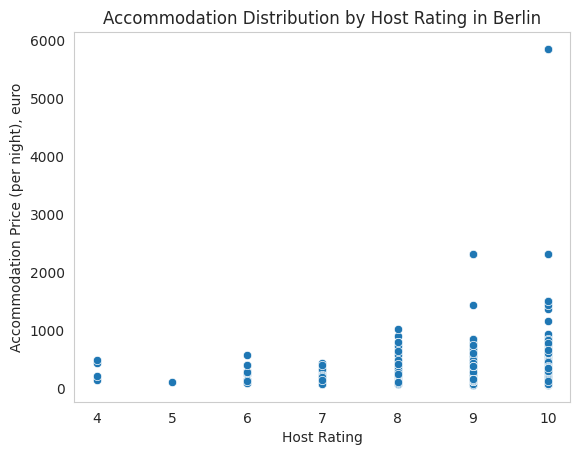

In [98]:
# Let's visualize the distribution of price and cleanliness rating

sns.scatterplot(data=df, x="cleanliness_rating", y="realsum", palette="Set2")
plt.title("Accommodation Distribution by Host Rating in Berlin")
plt.xlabel("Host Rating")
plt.ylabel("Accommodation Price (per night), euro")

plt.grid(False)
plt.show()

In [100]:
# Let's calculate the correlation coefficient for a nonparametric variable

stats.spearmanr(df['cleanliness_rating'], df['realsum'])

SignificanceResult(statistic=0.07282270421305015, pvalue=0.0013597143488359817)

Conclusion: there is no linear relationship between price and level of purity

# Conclusion



**1. Type of Accommodation:**

**Not shared rooms:**

*   Rooms may not be fully occupied, resulting in lower revenue per night as compared to the listed values in the table.
*   Maximum prices in this category are the lowest, limiting future price growth.
*   The lowest occupancy rate is 38.9%.

**Private rooms for 2 and 3 people have the highest maximum price, indicating a demand in the market. As landlords, we can increase prices with service and room equipment improvements.**

*   Occupancy for private rooms is 46.3%, with the entire room being rented out unlike shared rooms, potentially resulting in higher earnings for the landlord.
*   Larger rooms for rent for 4 or more people may be available in the market but could be unpopular, with a high probability of vacancies (especially off-season).
*   Prices do not depend on the day of the week.
*   There are the most rooms for 2 people in Berlin - 1176 units, indicating the highest demand and competition.

**Entire homes/apartments - Minimum and maximum prices for apartments for 2 people are higher than for rooms for 2 people, which, with slightly higher occupancy, can bring higher and more stable income, with less competition in this category.**

*   The highest occupancy rate is 46.9%.
*   There are a total of 359 apartments for 2 people in Berlin, which is the second most common type of accommodation, indicating the second most popular choice.

**Thus, the most popular types of accommodation for renting out are private rooms for 2 people and apartments. Considering that the occupancy rate and prices are slightly higher for apartments, it is more advantageous to invest in apartments. An alternative option is to rent out the apartment by rooms.**

**2. Number of Bedrooms:**

In general, the overwhelming majority of accommodations have 1 bedroom.

**3. Distance from the City Center and Metro**

There is a weak negative correlation between the cost of accommodation and the distance of the property from the city center and the metro.

The median rental price of an apartment/house for 2 people gradually decreases with distance from the center and from the metro.

**4. Accommodation Rating and Cleanliness Rating**

*   The accommodation price is not dependent on the cleanliness rating or whether the host has a superhost badge.
*   Properties with an overall rating above 70 can be purchased, as the rating does not significantly affect the accommodation price. However, the rating may affect the popularity of the accommodation and thus the number of vacant days during the year. However, this hypothesis cannot be verified due to lack of data.

**Based on the analysis, the ideal investment properties are 2-bedroom apartments or houses with 1 bedroom, located away from the city center. Achieving an overall rating above 70 is advisable for better marketability, but obtaining a Superhost award is not essential. It's not worth considering cleanliness ratings as a decisive factor in property selection.**

In [102]:
# houses that meet the criteria (as an example)

best_flats = df[(df['room_type'] == 'Entire home/apt')&
                       (df['metro_dist'] <= 0.313)&
                       (df['person_capacity'] == 2) &
                       (df['bedrooms'] == 1) &
                       (df['guest_satisfaction_overall'] > 70)]

In [106]:
# Mark the location of houses on the map with pop-up information

for index, row in df.iterrows():
    tooltip = (f"ID: {row['id']}<br>\
              Стоимость аренды: {round(row['realsum'], 2)} €<br>\
              Тип жилья: {row['room_type']} <br>\
              Вместимость: {row['person_capacity']} <br>\
              Статус superhost: {row['host_is_superhost']} <br>\
              Рейтинг чистоты: {row['cleanliness_rating']} <br>\
              Оценка постояльцев: {row['guest_satisfaction_overall']} <br>\
              Количество спален: {row['bedrooms']} <br>\
              Расстояние до центра: {round(row['dist'], 4)} км<br>\
              Расстояние до метро: {round(row['metro_dist'], 4)} км<br>\
              Широта и долгота: {row['lat'], row['lng']}"
              )
    color = 'red' if row['id'] in best_flats['id'].values else 'blue'
    folium.Marker(location=[row['lat'], row['lng']], tooltip=tooltip, icon=folium.Icon(color=color)).add_to(map_berlin)

In [107]:
map_berlin